In [ ]:
import numpy as np
import matplotlib.pyplot as plt

hbar = 1.0545718e-34 #planck's reduced constant
m = 9.10938356e-31  # electron mass

In [ ]:
# spatial domain
x_min = -2e-9
x_max =  2e-9
N = 2000 #Grid spaces
x = np.linspace(x_min, x_max, N)
dx = x[1] - x[0]

In [ ]:
def V_rectangular(x, V0=3*1.6e-19, width=3e-10, center=0.0):
    return np.where(np.abs(x-center) < width/2, V0, 0.0)

def V_gaussian(x, V0=3*1.6e-19, sigma=1e-10, center=0.0):
    return V0 * np.exp(-(x-center)**2 / (2*sigma**2))

def V_coulomb_smooth(x, Z=1, epsilon=1e-12):
    k = 8.9875517923e9
    e = 1.602e-19
    return k * Z * e**2 / np.sqrt(x**2 + epsilon**2)

def V_delta(x, g=3*1.6e-19, center=0.0):
    V = np.zeros_like(x)

    # Find index closest to center
    idx = np.argmin(np.abs(x - center))

    # A delta function is approximated as a spike at one point:
    V[idx] = g / dx   # ensures area = g

    return V


In [ ]:
barrier_type = "rect"    # "rect", "gauss","coul" or "delta"

# --- Step 1: build the raw barrier ---
if barrier_type == "rect":
    V_raw = V_rectangular(x)

elif barrier_type == "gauss":
    V_raw = V_gaussian(x)

elif barrier_type == "coul":
    V_raw = V_coulomb_smooth(x, Z=2)

elif barrier_type == "delta":
    V_raw = V_delta(x,g=target_area)


else:
    raise ValueError("Unknown barrier type.")
def barrier_area(V, dx):
    #we use the reiman sum to calculate the area under the barrier
    return np.sum(V) * dx

def normalize_barrier_area(V, target_area, dx):
    """Rescale V(x) so that its integral equals target_area."""
    current_area = barrier_area(V, dx)
    if current_area == 0:
        raise ValueError("Cannot normalize: barrier area is zero.")
    scale = target_area / current_area
    return V * scale
# --- Step 2: choose target area (use rectangular as reference) ---
V_ref_raw = V_rectangular(x, V0=3*1.6e-19, width=6e-10)
target_area = barrier_area(V_ref_raw, dx)

# --- Step 3: normalize the selected barrier ---
V = normalize_barrier_area(V_raw, target_area, dx)

# --- Step 4: print areas to verify ---
print("Reference rectangular area:", barrier_area(V_ref_raw, dx))
print(f"{barrier_type} barrier area:", barrier_area(V, dx))

Reference rectangular area: 2.8814407203599825e-28
rect barrier area: 2.881440720359983e-28


In [ ]:
# Kinetic energy operator (second derivative)
diag = np.full(N, -2.0)
off  = np.full(N-1, 1.0)

Tmat = (-hbar**2 / (2*m*dx**2)) * (
    np.diag(diag) + np.diag(off,1) + np.diag(off,-1)
)

# Full Hamiltonian
H = Tmat + np.diag(V)

In [ ]:
dt = 1e-18

I = np.eye(N)
A = I + 1j * H * dt / (2*hbar)
B = I - 1j * H * dt / (2*hbar)

A_inv = np.linalg.inv(A)

def time_step(psi):
    return A_inv @ (B @ psi)

In [ ]:
x0 = -8e-10
sigma = 1e-10
k0 = 2e10  # realistic k giving E ~ 2 eV

def gaussian_packet(x, x0, k0, sigma):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j*k0*(x-x0))
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*dx)
    return psi

psi = gaussian_packet(x, x0, k0, sigma)

In [ ]:
steps = 8000

for step in range(steps):
    psi = time_step(psi)

In [ ]:
def transmission_probability(psi, x, dx, barrier_center=0.0):
    mask = x > barrier_center
    return np.sum(np.abs(psi[mask])**2) * dx

T = transmission_probability(psi, x, dx)
print("Transmission:", T)

Transmission: 0.4113700644898857


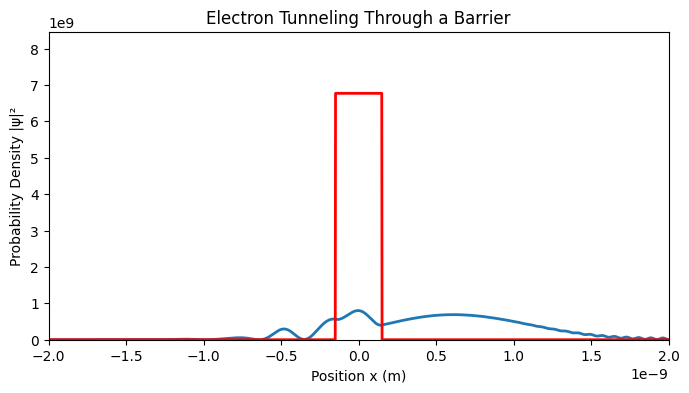

In [ ]:
from IPython.display import HTML
import matplotlib.animation as animation

# --- Make a fresh initial wavepacket for the animation ---
psi_anim = gaussian_packet(x, x0, k0, sigma).copy()

fig, ax = plt.subplots(figsize=(8,4))
line, = ax.plot([], [], lw=2)
barrier_line, = ax.plot([], [], color="red", lw=2)

ax.set_xlim(x_min, x_max)
ax.set_ylim(0, np.max(np.abs(psi_anim)**2)*1.5)
ax.set_xlabel("Position x (m)")
ax.set_ylabel("Probability Density |ψ|²")
ax.set_title("Electron Tunneling Through a Barrier")

# Precompute the barrier height to plot it for reference
barrier_norm = V / np.max(V) * np.max(np.abs(psi_anim)**2) * 1.2

def init():
    line.set_data([], [])
    barrier_line.set_data(x, barrier_norm)
    return line, barrier_line

def animate(frame):
    global psi_anim
    psi_anim = time_step(psi_anim)
    line.set_data(x, np.abs(psi_anim)**2)
    return line, barrier_line

ani = animation.FuncAnimation(
    fig, animate, init_func=init,
    frames=600, interval=30, blit=True
)

HTML(ani.to_jshtml())